In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('..')
import os
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GCNConv, dense_diff_pool
import torch_explain as te
from torch_explain.logic.nn import entropy
from torch_explain.logic.metrics import test_explanation, complexity

import numpy as np
import pandas as pd
from pytorch_lightning.utilities.seed import seed_everything
from scipy.spatial.distance import cdist
from sympy import to_dnf, lambdify
from sklearn.metrics.cluster import homogeneity_score, completeness_score

from sklearn.cluster import KMeans

import clustering_utils
import data_utils
import lens_utils
import model_utils
import persistence_utils
import visualisation_utils

In [3]:
# constants
DATASET_NAME = "BA_Community"
MODEL_NAME = f"GCN for {DATASET_NAME}"
NUM_CLASSES = 8
K = 30

TRAIN_TEST_SPLIT = 0.8

NUM_HIDDEN_UNITS = 20
CLUSTER_ENCODING_SIZE = 20
EPOCHS = 10000
LR = 0.0001

NUM_NODES_VIEW = 5
NUM_EXPANSIONS = 2

LAYER_NUM = 5
LAYER_KEY = "conv5"

visualisation_utils.set_rc_params()

In [4]:
# model definition
class GCN(nn.Module):
    def __init__(self, num_in_features, num_hidden_features, num_classes):
        super(GCN, self).__init__()
        
        self.conv0 = GCNConv(num_in_features, num_hidden_features)
        self.conv1 = GCNConv(num_hidden_features, num_hidden_features)
        self.conv2 = GCNConv(num_hidden_features, num_hidden_features)
        self.conv3 = GCNConv(num_hidden_features, num_hidden_features)
        self.conv4 = GCNConv(num_hidden_features, num_hidden_features)
        self.conv5 = GCNConv(num_hidden_features, num_hidden_features)
                
        # linear layers
        self.linear = nn.Linear(num_hidden_features, num_classes)

    def forward(self, x, edge_index):
        x = self.conv0(x, edge_index)
        x = F.leaky_relu(x)

        x = self.conv1(x, edge_index)
        x = F.leaky_relu(x)

        x = self.conv2(x, edge_index)
        x = F.leaky_relu(x)
        
        x = self.conv3(x, edge_index)
        x = F.leaky_relu(x)
        
        x = self.conv4(x, edge_index)
        x = F.leaky_relu(x)
        
        x = self.conv5(x, edge_index)
        x = F.leaky_relu(x)
        
        x = self.linear(x)
                
        return F.log_softmax(x, dim=-1)

In [5]:
def run_experiment(data, seed, path, load_pretrained=False):
    persistence_utils.save_config(seed, DATASET_NAME, MODEL_NAME, NUM_CLASSES, K, TRAIN_TEST_SPLIT, NUM_HIDDEN_UNITS, EPOCHS, LR, NUM_NODES_VIEW, NUM_EXPANSIONS, LAYER_NUM, LAYER_KEY, path)

    x = data["x"]
    edges = data['edges']
    edges_t = data['edge_list'].numpy()
    y = data["y"]
    train_mask = data["train_mask"]
    test_mask = data["test_mask"]

    # model training
    model = GCN(data["x"].shape[1], NUM_HIDDEN_UNITS, NUM_CLASSES)
    
    if load_pretrained:
        model = persistence_utils.load_model(model, path, 'model.z')
        model_utils.activation_list = persistence_utils.load_experiment(path, 'activation_list.z')
        
    else:
        # register hooks to track activation
        model = model_utils.register_hooks(model)

        # train 
        train_acc, test_acc, train_loss, test_loss = model_utils.train(model, data, EPOCHS, LR, if_interpretable_model=False)
        persistence_utils.persist_model(model, path, 'model.z')
        
        visualisation_utils.plot_model_accuracy(train_acc, test_acc, MODEL_NAME, path)
        visualisation_utils.plot_model_loss(train_loss, test_loss, MODEL_NAME, path)
        
        # get model activations for complete dataset
        pred = model(x, edges)
        persistence_utils.persist_experiment(model_utils.activation_list, path, 'activation_list.z')
        
    activation = torch.squeeze(model_utils.activation_list[LAYER_KEY]).detach().numpy()

    # find centroids
    kmeans_model = KMeans(n_clusters=K, random_state=seed)
    kmeans_model = kmeans_model.fit(activation[train_mask])
    used_centroid_labels = kmeans_model.predict(activation)
    centroid_labels = np.sort(np.unique(used_centroid_labels))
    centroids = kmeans_model.cluster_centers_
    
    persistence_utils.persist_experiment(kmeans_model, path, 'kmeans_model.z')
    persistence_utils.persist_experiment(centroids, path, 'centroids.z')
    persistence_utils.persist_experiment(centroid_labels, path, 'centroid_labels.z')
    persistence_utils.persist_experiment(used_centroid_labels, path, 'used_centroid_labels.z')
        
    print(f"Number of cenroids: {len(centroids)}")
    
    # plot concept heatmaps
    visualisation_utils.plot_concept_heatmap(centroids, used_centroid_labels, y, used_centroid_labels, MODEL_NAME, LAYER_NUM, path)
    
    # concept alignment
    homogeneity = homogeneity_score(y, used_centroid_labels)
    
    # clustering efficency
    completeness = completeness_score(y, used_centroid_labels)
    
    # calculate cluster sizing
    cluster_counts = visualisation_utils.print_cluster_counts(used_centroid_labels)
    
    concept_metrics = [('homogeneity', homogeneity), ('completeness', completeness), ('cluster_count', cluster_counts)]
    persistence_utils.persist_experiment(concept_metrics, path, 'concept_metrics.z')

    print(f"Concept homogeneity score: {homogeneity}")
    print(f"Concept completeness score: {completeness}")

    # plot clustering
    visualisation_utils.plot_clustering(seed, activation, y, centroids, centroid_labels, used_centroid_labels, MODEL_NAME, LAYER_NUM, path)

    # plot samples
    sample_graphs, sample_feat = visualisation_utils.plot_samples(kmeans_model, activation, y, LAYER_NUM, len(centroids), "Differential Clustering", "Raw", NUM_NODES_VIEW, edges_t, NUM_EXPANSIONS, path)
    persistence_utils.persist_experiment(sample_graphs, path, 'sample_graphs.z')
    persistence_utils.persist_experiment(sample_feat, path, 'sample_feat.z')
    
    # clean up
    plt.close()

Global seed set to 42


Task: Node Classification
Number of features:  1400
Number of labels:  1400
Number of classes:  1400
Number of edges:  2

START EXPERIMENT-----------------------------------------



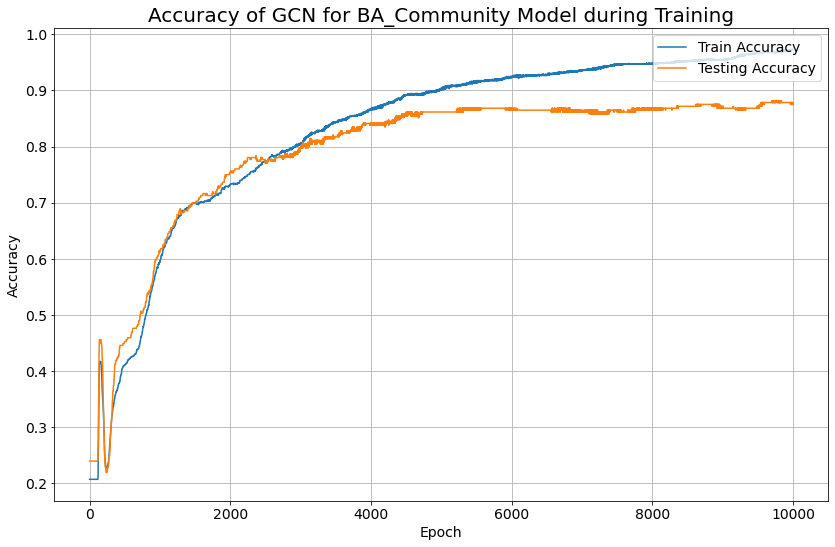

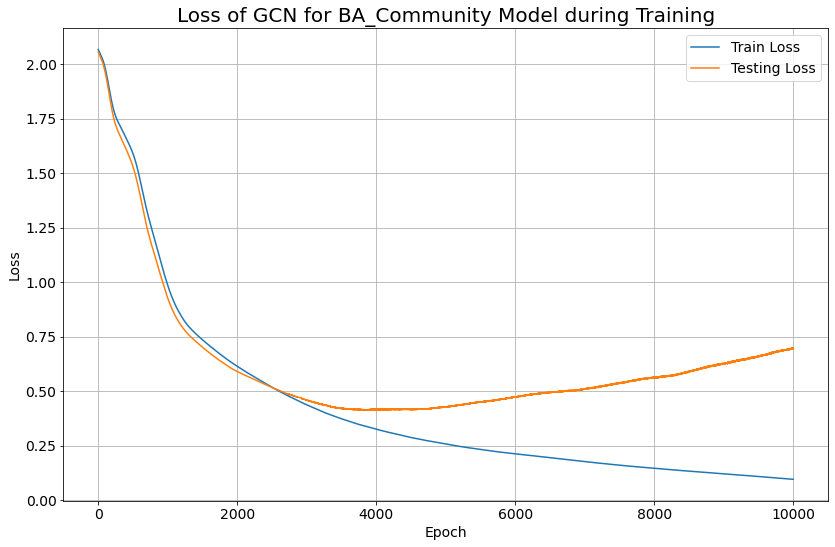

Number of cenroids: 30


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/src/standard_model_notebooks/../visualisation_utils.py:87: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.savefig(os.path.join(path, f"concept_heatmap_layer{layer_num}.png"))


Cluster sizes by cluster id:
	Cluster 0: 56
	Cluster 1: 15
	Cluster 2: 121
	Cluster 3: 37
	Cluster 4: 52
	Cluster 5: 26
	Cluster 6: 78
	Cluster 7: 63
	Cluster 8: 31
	Cluster 9: 52
	Cluster 10: 4
	Cluster 11: 99
	Cluster 12: 8
	Cluster 13: 34
	Cluster 14: 21
	Cluster 15: 45
	Cluster 16: 27
	Cluster 17: 13
	Cluster 18: 61
	Cluster 19: 76
	Cluster 20: 25
	Cluster 21: 86
	Cluster 22: 79
	Cluster 23: 47
	Cluster 24: 24
	Cluster 25: 31
	Cluster 26: 20
	Cluster 27: 48
	Cluster 28: 39
	Cluster 29: 82
Concept homogeneity score: 0.7444986114661531
Concept completeness score: 0.4581235335094141


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


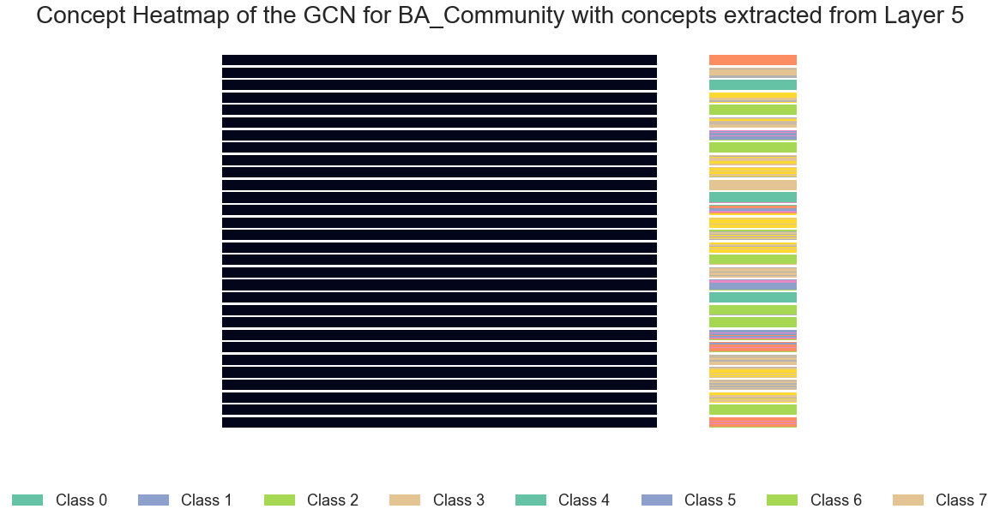

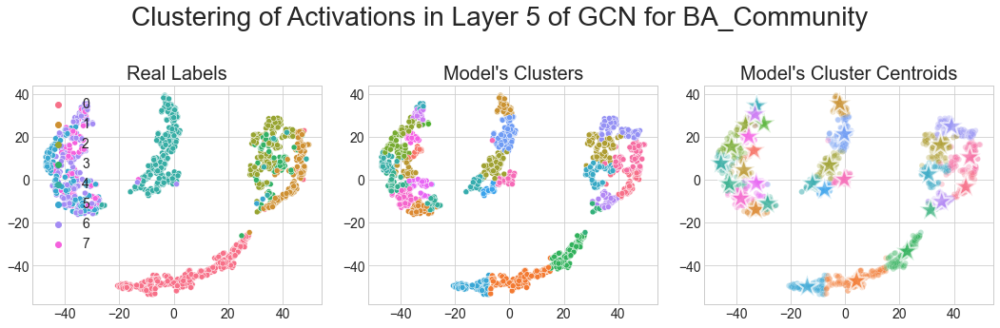

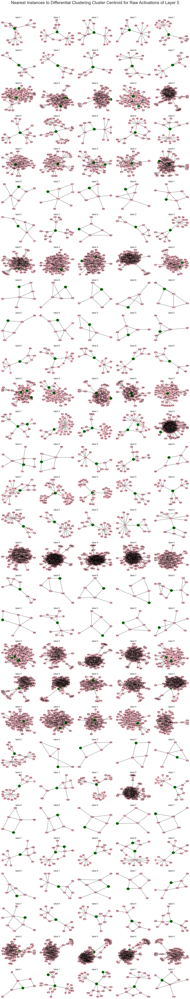

Global seed set to 19



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



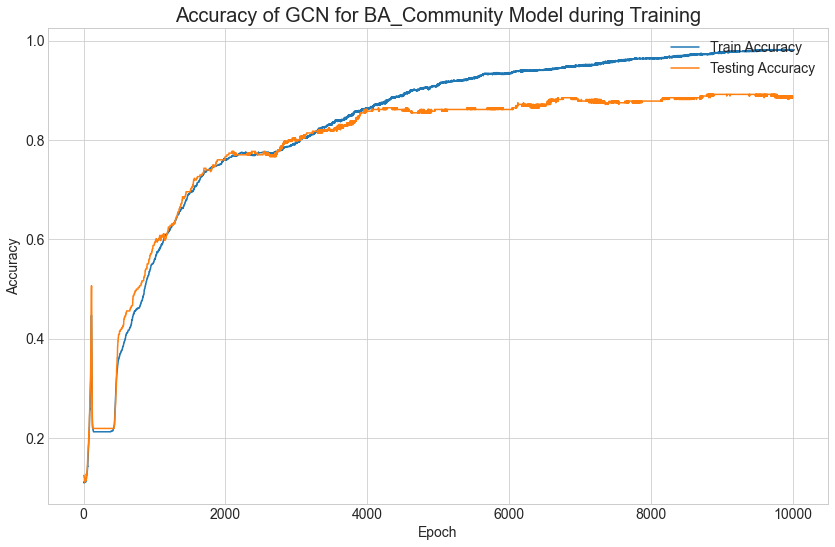

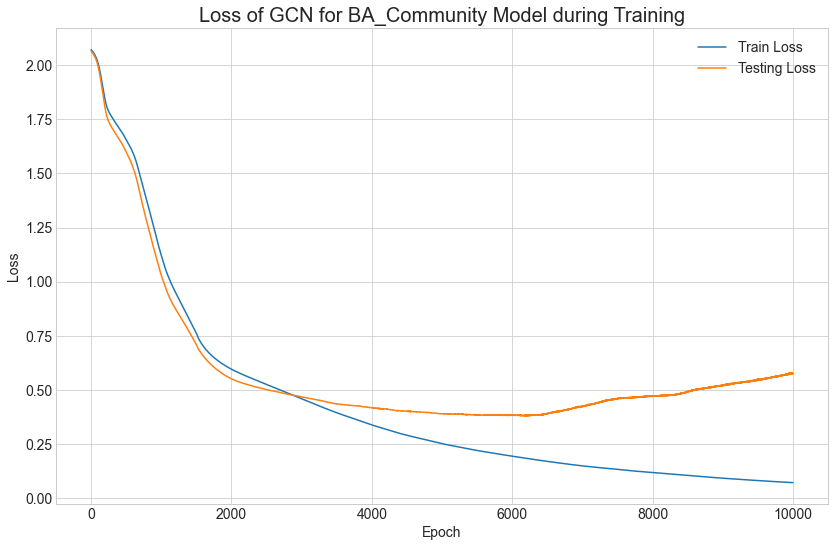

Number of cenroids: 30


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/src/standard_model_notebooks/../visualisation_utils.py:87: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.savefig(os.path.join(path, f"concept_heatmap_layer{layer_num}.png"))


Cluster sizes by cluster id:
	Cluster 0: 57
	Cluster 1: 28
	Cluster 2: 85
	Cluster 3: 30
	Cluster 4: 54
	Cluster 5: 67
	Cluster 6: 31
	Cluster 7: 45
	Cluster 8: 59
	Cluster 9: 58
	Cluster 10: 81
	Cluster 11: 30
	Cluster 12: 15
	Cluster 13: 74
	Cluster 14: 53
	Cluster 15: 16
	Cluster 16: 50
	Cluster 17: 91
	Cluster 18: 39
	Cluster 19: 53
	Cluster 20: 17
	Cluster 21: 98
	Cluster 22: 16
	Cluster 23: 18
	Cluster 24: 21
	Cluster 25: 37
	Cluster 26: 64
	Cluster 27: 42
	Cluster 28: 63
	Cluster 29: 8
Concept homogeneity score: 0.7283570843456452
Concept completeness score: 0.44211956808080444


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


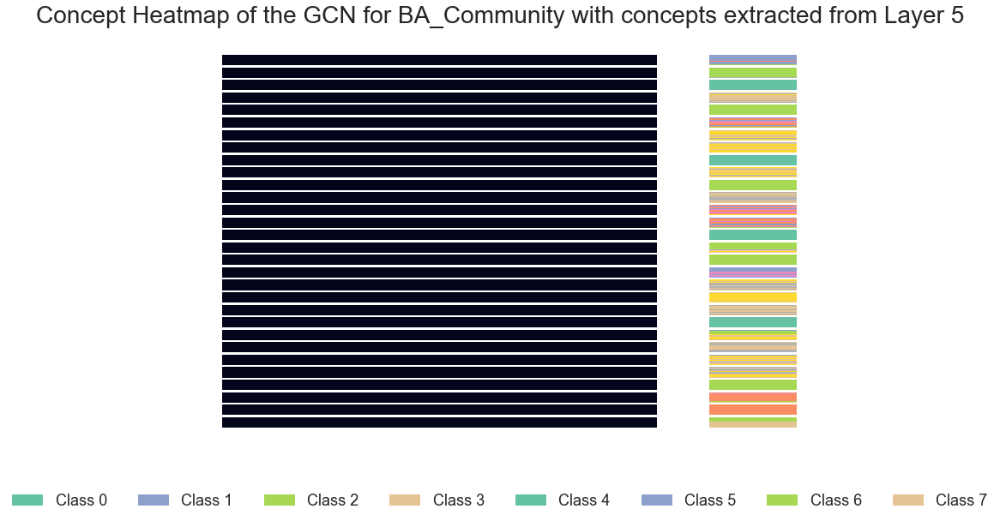

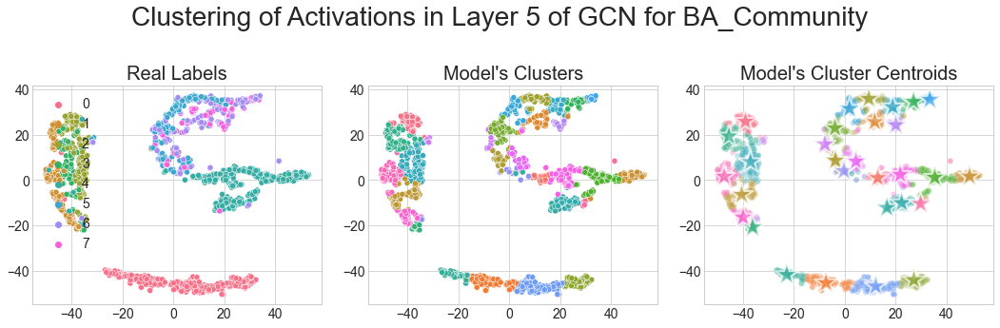

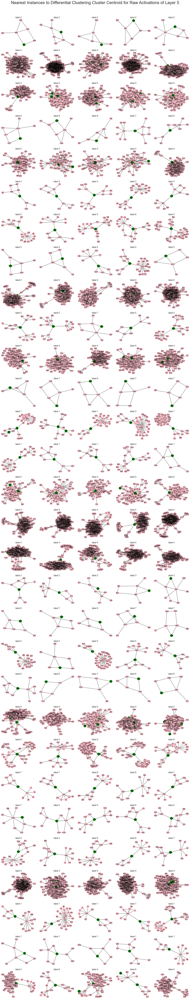

Global seed set to 76



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



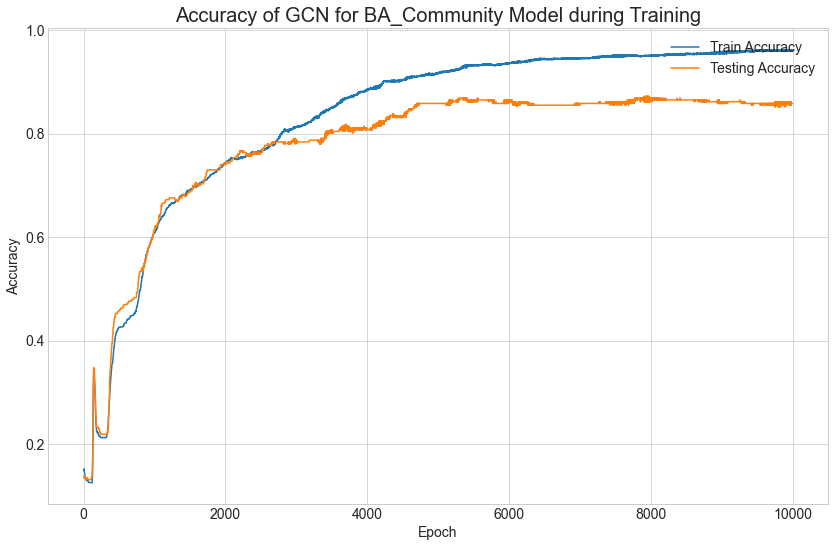

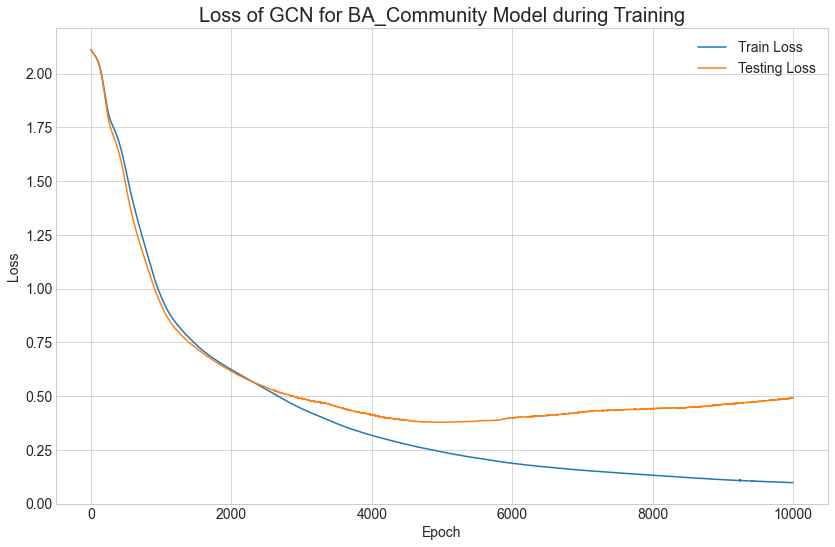

Number of cenroids: 30


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/src/standard_model_notebooks/../visualisation_utils.py:87: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.savefig(os.path.join(path, f"concept_heatmap_layer{layer_num}.png"))


Cluster sizes by cluster id:
	Cluster 0: 20
	Cluster 1: 83
	Cluster 2: 116
	Cluster 3: 22
	Cluster 4: 21
	Cluster 5: 40
	Cluster 6: 30
	Cluster 7: 33
	Cluster 8: 8
	Cluster 9: 61
	Cluster 10: 83
	Cluster 11: 55
	Cluster 12: 33
	Cluster 13: 28
	Cluster 14: 23
	Cluster 15: 39
	Cluster 16: 55
	Cluster 17: 95
	Cluster 18: 28
	Cluster 19: 43
	Cluster 20: 85
	Cluster 21: 65
	Cluster 22: 41
	Cluster 23: 42
	Cluster 24: 53
	Cluster 25: 11
	Cluster 26: 32
	Cluster 27: 79
	Cluster 28: 18
	Cluster 29: 58
Concept homogeneity score: 0.7137702671193487
Concept completeness score: 0.4353689981435307


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


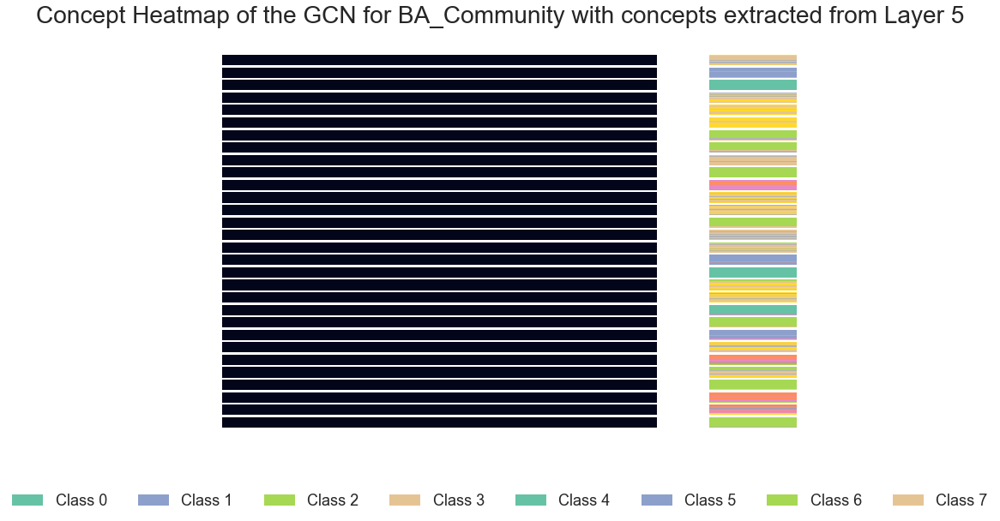

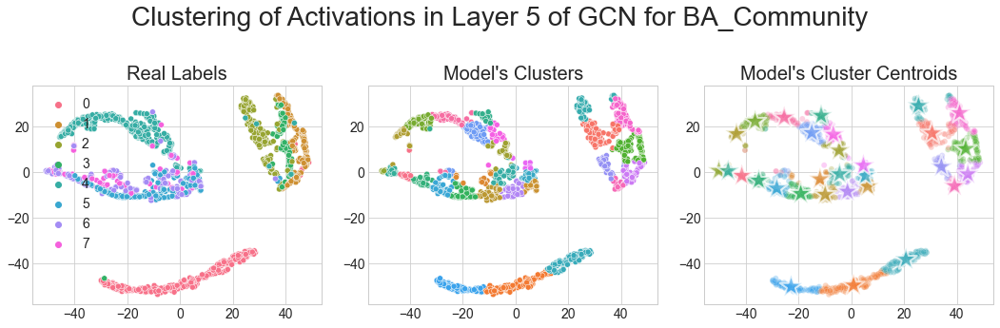

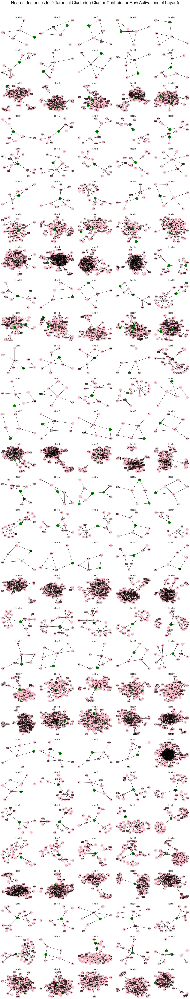

Global seed set to 58



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



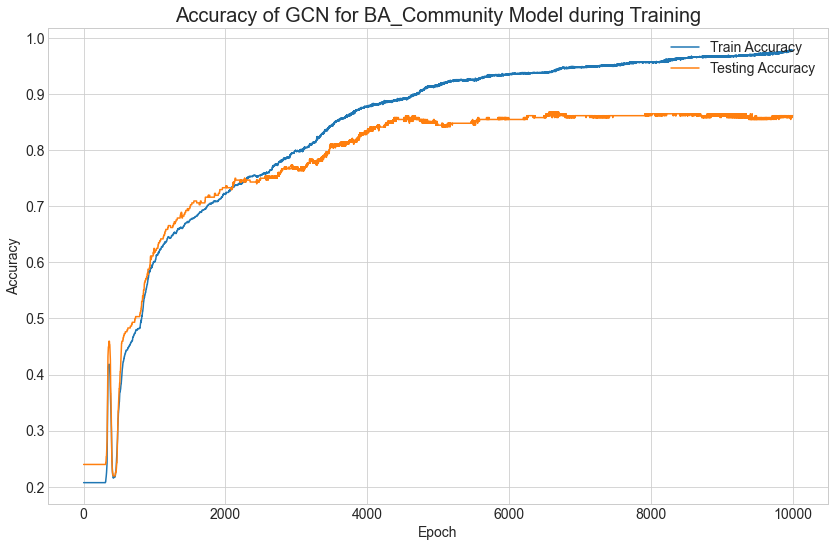

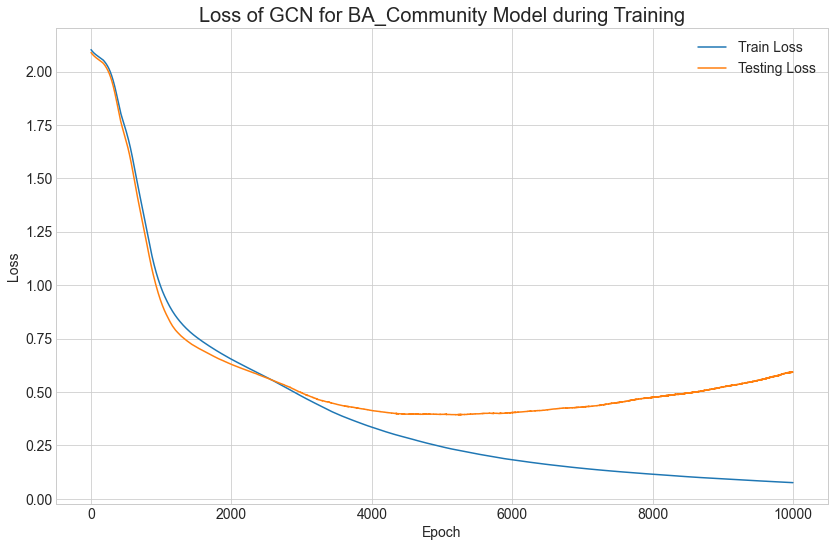

Number of cenroids: 30


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/src/standard_model_notebooks/../visualisation_utils.py:87: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.savefig(os.path.join(path, f"concept_heatmap_layer{layer_num}.png"))


Cluster sizes by cluster id:
	Cluster 0: 40
	Cluster 1: 81
	Cluster 2: 132
	Cluster 3: 35
	Cluster 4: 23
	Cluster 5: 23
	Cluster 6: 15
	Cluster 7: 61
	Cluster 8: 100
	Cluster 9: 62
	Cluster 10: 74
	Cluster 11: 14
	Cluster 12: 42
	Cluster 13: 93
	Cluster 14: 24
	Cluster 15: 22
	Cluster 16: 40
	Cluster 17: 53
	Cluster 18: 30
	Cluster 19: 32
	Cluster 20: 11
	Cluster 21: 29
	Cluster 22: 116
	Cluster 23: 34
	Cluster 24: 30
	Cluster 25: 46
	Cluster 26: 22
	Cluster 27: 15
	Cluster 28: 58
	Cluster 29: 43
Concept homogeneity score: 0.7032774903731144
Concept completeness score: 0.4340400470169934


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


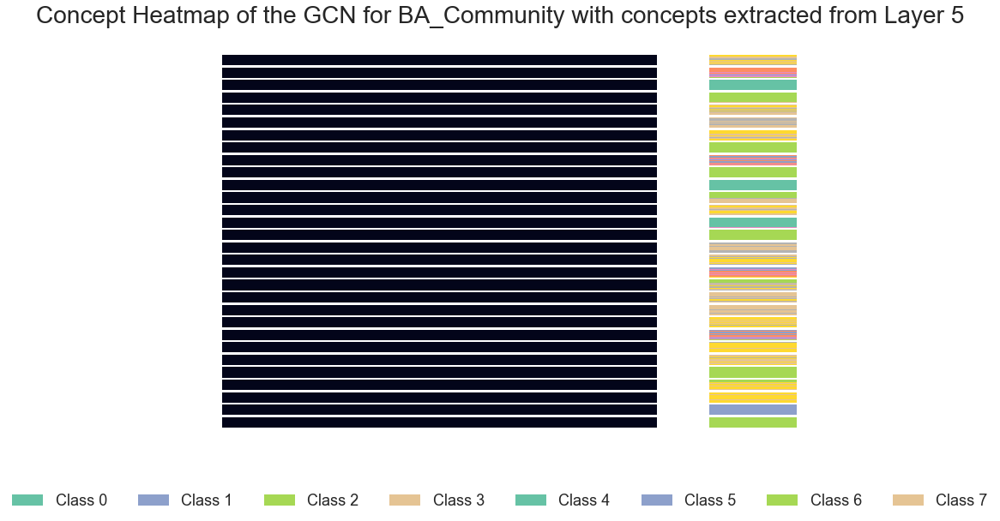

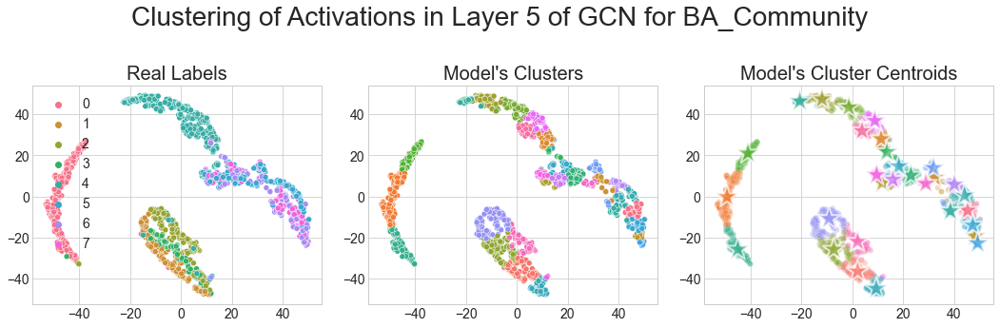

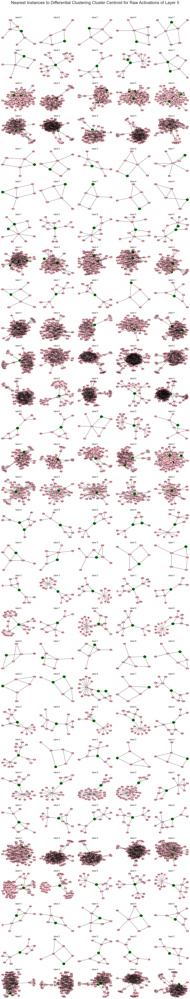

Global seed set to 92



END EXPERIMENT-------------------------------------------


START EXPERIMENT-----------------------------------------



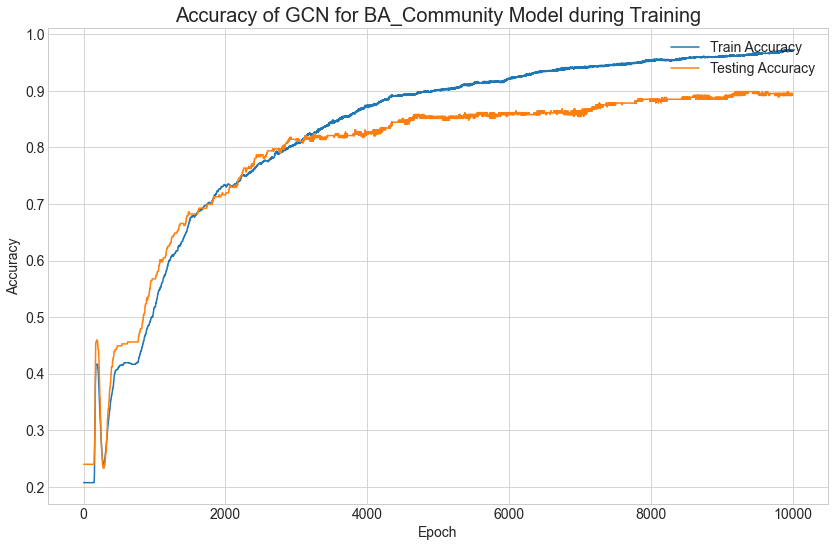

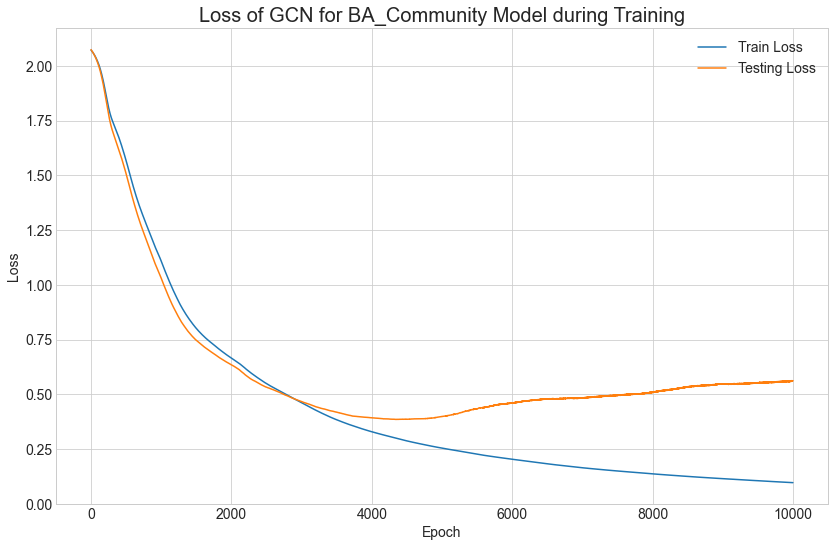

Number of cenroids: 30


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/utils.py:95: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.draw()
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/src/standard_model_notebooks/../visualisation_utils.py:87: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.savefig(os.path.join(path, f"concept_heatmap_layer{layer_num}.png"))


Cluster sizes by cluster id:
	Cluster 0: 148
	Cluster 1: 33
	Cluster 2: 17
	Cluster 3: 23
	Cluster 4: 34
	Cluster 5: 2
	Cluster 6: 29
	Cluster 7: 22
	Cluster 8: 80
	Cluster 9: 45
	Cluster 10: 40
	Cluster 11: 34
	Cluster 12: 20
	Cluster 13: 48
	Cluster 14: 49
	Cluster 15: 47
	Cluster 16: 47
	Cluster 17: 32
	Cluster 18: 82
	Cluster 19: 24
	Cluster 20: 25
	Cluster 21: 129
	Cluster 22: 66
	Cluster 23: 65
	Cluster 24: 8
	Cluster 25: 68
	Cluster 26: 15
	Cluster 27: 21
	Cluster 28: 120
	Cluster 29: 27
Concept homogeneity score: 0.723480895219333
Concept completeness score: 0.4538099718612719


/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword a

<Figure size 1080x360 with 0 Axes>

/Users/luciecharlottemagister/Documents/Cambridge/PhD/Projects/NEWRON_LEN/newron_len_env/lib/python3.9/site-packages/IPython/core/pylabtools.py:132: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


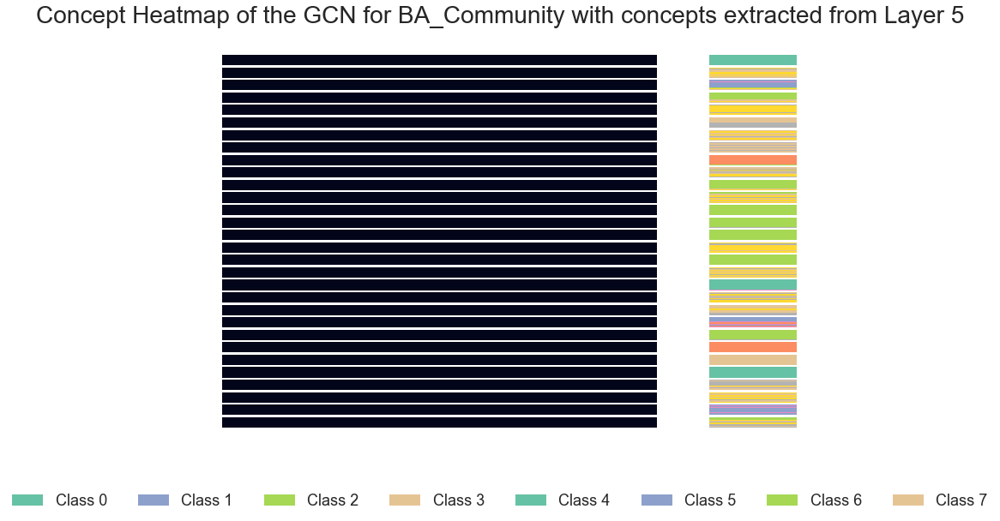

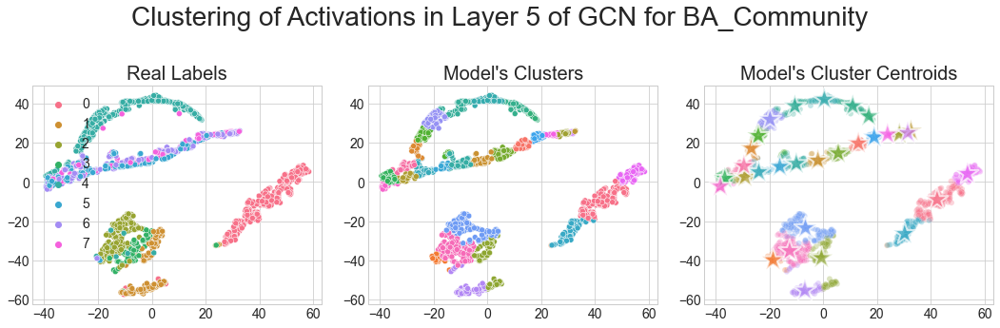

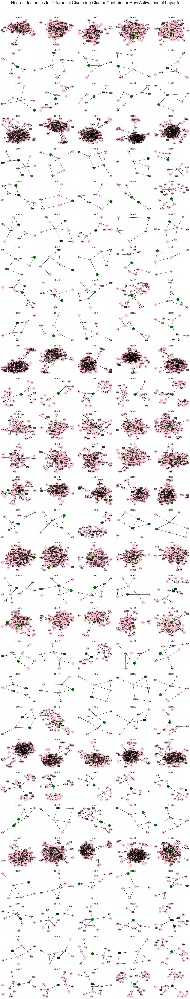


END EXPERIMENT-------------------------------------------



In [6]:
# run multiple times for confidence interval - seeds generated using Google's random number generator
random_seeds = [42, 19, 76, 58, 92]

# load data
G, labels = data_utils.load_syn_data(DATASET_NAME, path_prefix="../")
data = data_utils.prepare_syn_data(G, labels, TRAIN_TEST_SPLIT)

for seed in random_seeds:
    print("\nSTART EXPERIMENT-----------------------------------------\n")
    seed_everything(seed)
    
    path = os.path.join("../..", "output", "Standard_" + DATASET_NAME, f"seed_{seed}")
    data_utils.create_path(path)
    
    persistence_utils.persist_experiment(data, path, 'data.z')
    
    run_experiment(data, seed, path, load_pretrained=False)
    
    print("\nEND EXPERIMENT-------------------------------------------\n")